In [1]:
from s04utils.modules.load.Timestamps import Timestamps
from s04utils.modules.load.BinnedTimestamps import BinnedTimestamps
from s04utils.modules.analyze import HMM_analysis as hmma

from bokeh.plotting import figure, show, output_notebook, curdoc
from matplotlib_inline.backend_inline import set_matplotlib_formats

import pandas as pd 
import numpy as np
import seaborn as sns
from matplotlib import pyplot as plt

import os
import glob


from sfHMM import sfHMM1
from sfHMM.gmm import GMMs


In [2]:
# Set quality for plt plots
set_matplotlib_formats('retina')

# Set output style for bokeh plots
#curdoc().theme = 'dark_minimal'
output_notebook()

Loading BokehJS ...

In [3]:
SOURCE_PATH = '/Users/kappel/Messungen/Setup04/JaKa/post_hack/23_08_29/77K-33nM-eGFP-vitrified/10uW/timestamps/tt_eGFP_33nM_NaP_100mM_ph7dot5_Treh7dot5_10uW_77K_circpol_031.h5'

In [4]:
PATHS = [
    '/Users/kappel/Messungen/Setup04/JaKa/post_hack/23_08_29/77K-33nM-eGFP-vitrified/10uW/timestamps/tt_eGFP_33nM_NaP_100mM_ph7dot5_Treh7dot5_10uW_77K_circpol_031.h5',
    '/Users/kappel/Messungen/Setup04/JaKa/post_hack/23_08_29/77K-33nM-eGFP-vitrified/10uW/timestamps/tt_eGFP_33nM_NaP_100mM_ph7dot5_Treh7dot5_10uW_77K_circpol_001.h5',
    '/Users/kappel/Messungen/Setup04/JaKa/post_hack/23_08_29/77K-33nM-eGFP-vitrified/10uW/timestamps/tt_eGFP_33nM_NaP_100mM_ph7dot5_Treh7dot5_10uW_77K_circpol_013.h5',
    '/Users/kappel/Messungen/Setup04/JaKa/post_hack/23_08_29/77K-33nM-eGFP-vitrified/10uW/timestamps/tt_eGFP_33nM_NaP_100mM_ph7dot5_Treh7dot5_10uW_77K_circpol_015.h5',
    '/Users/kappel/Messungen/Setup04/JaKa/post_hack/23_08_29/77K-33nM-eGFP-vitrified/10uW/timestamps/tt_eGFP_33nM_NaP_100mM_ph7dot5_Treh7dot5_10uW_77K_circpol_018.h5',
    '/Users/kappel/Messungen/Setup04/JaKa/post_hack/23_08_29/77K-33nM-eGFP-vitrified/10uW/timestamps/tt_eGFP_33nM_NaP_100mM_ph7dot5_Treh7dot5_10uW_77K_circpol_022.h5',
]

In [5]:
# Load timestamps from file
ts_binned = BinnedTimestamps(path=SOURCE_PATH, bin_width=0.001)

# create list with binne timestamps objects for each file
ts_binned_list = [BinnedTimestamps(path=path, bin_width=0.001) for path in PATHS]

In [6]:
for ts_binned in ts_binned_list:
    hmma.create_bokeh_plot(ts_binned)

In [7]:
#cutoff_pos, viterbi_steps = hmma.find_last_steps(ts_binned)
#print(hmma.find_cutoffset(viterbi_steps))

In [8]:
## Iterate over detectors in binned timestamps
#for detector in ts_binned.as_dataframe.columns:
#    gmms = GMMs(ts_binned.as_dataframe[detector][0:cutoff_pos[detector]], krange=(2, 6))
#    gmms.fit()
#    #gmms.show_aic_bic()
#    #gmms.plot_all()
#    gmms_opt_n = gmms.get_optimal(criterion="bic").n_components
#    sf = sfHMM1(ts_binned.as_dataframe[detector][0:cutoff_pos[detector]], krange=(2, gmms_opt_n), model='p', name=detector).run_all(plot=False)
#    hmma.plot_viterbi(ts_binned, sf)

In [9]:
# Create list with binned timestamps from detector_sum of each file
ts_array_list = []
for ts_binned in ts_binned_list:
    ts_array_list.append(ts_binned.as_dataframe['detector_sum'].to_numpy())

time_traces = ts_array_list


In [16]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Masking, BatchNormalization
from tensorflow.keras.optimizers.legacy import Adam
from sklearn.cluster import KMeans
from tensorflow.keras.preprocessing.sequence import pad_sequences
import numpy as np

# Assume 'time_traces' is your dataset of intensity trajectories

# Padding sequences to a fixed length
max_length = max(len(seq) for seq in time_traces)
padded_sequences = pad_sequences(time_traces, maxlen=max_length, dtype='float32', padding='post', truncating='post')

# Reshape padded sequences for LSTM input
X = np.array(padded_sequences)
X = X.reshape((X.shape[0], X.shape[1], 1))  # Reshape for LSTM input

print(X)

# Print shape of input data
print(X.shape)

# Print information about the model
print('Input shape:', X.shape[1:])
print('Output shape:', X.shape[1:])
print('Batch size:', 1)
print('Time steps:', X.shape[1])
print('Features:', X.shape[2])
print('Max. length', max_length)
print('Number of samples:', X.shape[0])
print(padded_sequences)

[[[15.]
  [11.]
  [12.]
  ...
  [ 0.]
  [ 0.]
  [ 0.]]

 [[23.]
  [19.]
  [ 9.]
  ...
  [ 0.]
  [ 0.]
  [ 0.]]

 [[14.]
  [ 8.]
  [ 4.]
  ...
  [ 0.]
  [ 0.]
  [ 0.]]

 [[18.]
  [ 6.]
  [23.]
  ...
  [ 0.]
  [ 0.]
  [ 0.]]

 [[21.]
  [15.]
  [21.]
  ...
  [ 0.]
  [ 0.]
  [ 0.]]

 [[27.]
  [24.]
  [16.]
  ...
  [ 2.]
  [ 2.]
  [ 7.]]]
(6, 107826, 1)
Input shape: (107826, 1)
Output shape: (107826, 1)
Batch size: 1
Time steps: 107826
Features: 1
Max. length 107826
Number of samples: 6
[[15. 11. 12. ...  0.  0.  0.]
 [23. 19.  9. ...  0.  0.  0.]
 [14.  8.  4. ...  0.  0.  0.]
 [18.  6. 23. ...  0.  0.  0.]
 [21. 15. 21. ...  0.  0.  0.]
 [27. 24. 16. ...  2.  2.  7.]]


In [87]:

# Build and train the LSTM model to learn representations
model = Sequential()
model.add(Masking(mask_value=0., input_shape=(X.shape[1], 1)))  # Masking layer to handle padded zeros
model.add(LSTM(50, activation='tanh', return_sequences=True))  # LSTM layer with 50 units
model.add(BatchNormalization())  # Add a BatchNormalization layer
model.add(Dense(1))  # Add a Dense layer to transform the outputs back to the original size
model.compile(optimizer='adam', loss='mse')

# Train the LSTM model
model.fit(X, X, epochs=10, batch_size=32)


Epoch 1/10
1/1 [==============================] - 97s 97s/step - loss: 64.9178
Epoch 2/10
1/1 [==============================] - 91s 91s/step - loss: 61.5321
Epoch 3/10
1/1 [==============================] - 99s 99s/step - loss: 58.6215
Epoch 4/10
1/1 [==============================] - 98s 98s/step - loss: 56.0946
Epoch 5/10
1/1 [==============================] - 97s 97s/step - loss: 53.8893
Epoch 6/10
1/1 [==============================] - 95s 95s/step - loss: 51.9654
Epoch 7/10
1/1 [==============================] - 93s 93s/step - loss: 50.2973
Epoch 8/10
1/1 [==============================] - 98s 98s/step - loss: 48.8625
Epoch 9/10
1/1 [==============================] - 95s 95s/step - loss: 47.6327
Epoch 10/10
1/1 [==============================] - 100s 100s/step - loss: 46.5787


In [94]:

# Extract representations/embeddings from the LSTM
get_embeddings = Sequential(model.layers[:-1])  # Remove last layer for embeddings
print(get_embeddings.summary())
print(X)
sequence_embeddings = get_embeddings.predict(X)
print(sequence_embeddings)

# Flatten the embeddings
sequence_embeddings_flat = sequence_embeddings.reshape(sequence_embeddings.shape[0], -1)

print(sequence_embeddings_flat)

# Apply K-means clustering to the flattened embeddings
num_clusters = 2  # Example number of clusters
kmeans = KMeans(n_clusters=num_clusters)
cluster_labels = kmeans.fit_predict(sequence_embeddings_flat)


Model: "sequential_29"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 masking_6 (Masking)         (None, 107826, 1)         0         
                                                                 
 lstm_6 (LSTM)               (None, 107826, 50)        10400     
                                                                 
 batch_normalization_6 (Bat  (None, 107826, 50)        200       
 chNormalization)                                                
                                                                 
Total params: 10600 (41.41 KB)
Trainable params: 10500 (41.02 KB)
Non-trainable params: 100 (400.00 Byte)
_________________________________________________________________
None
[[[15.]
  [11.]
  [12.]
  ...
  [ 0.]
  [ 0.]
  [ 0.]]

 [[23.]
  [19.]
  [ 9.]
  ...
  [ 0.]
  [ 0.]
  [ 0.]]

 [[14.]
  [ 8.]
  [ 4.]
  ...
  [ 0.]
  [ 0.]
  [ 0.]]

 [[18.]
  [ 6.]
  [23.]
  ...
  [ 0.]


/opt/homebrew/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


[1 1 1 0 1 0]


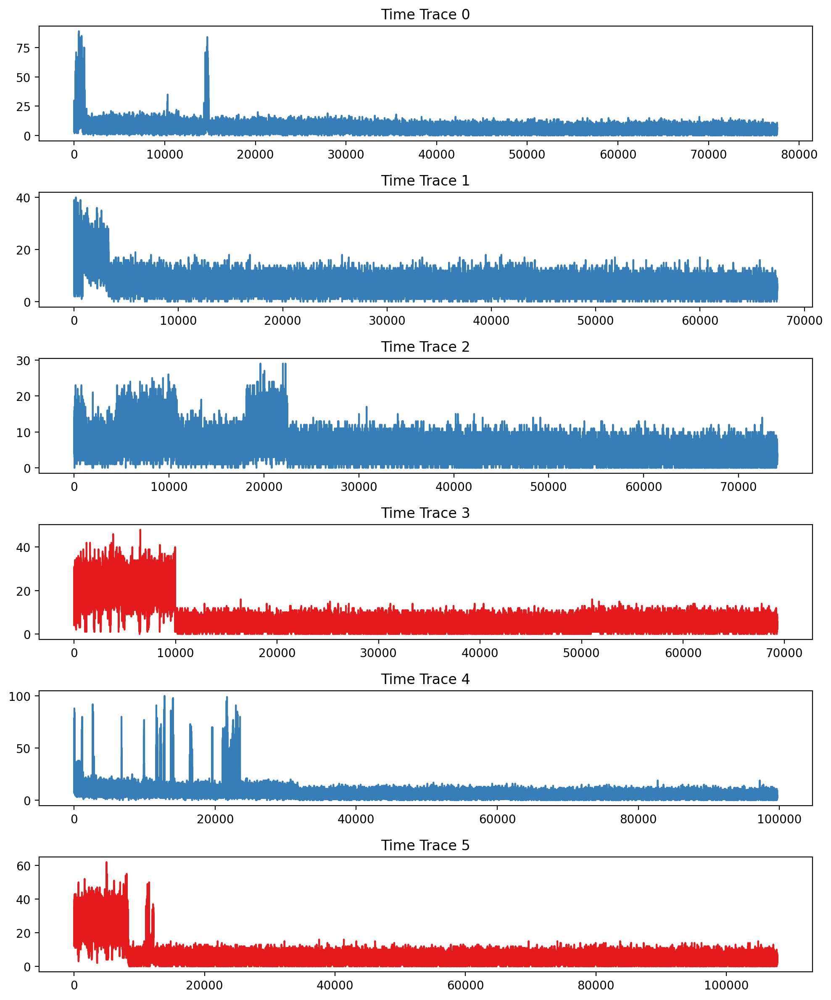

In [95]:
print(cluster_labels)

# Define colors for each cluster label, use color set from seaborn
colors = sns.color_palette('Set1', num_clusters)

# Create a figure with as many subplots as there are time traces
fig, axs = plt.subplots(len(ts_binned_list), 1, figsize=(10, 2 * len(ts_binned_list)))

# Plot each time trace in its own subplot
for i, ts in enumerate(ts_binned_list):
    # Determine which cluster the current trace belongs to
    cluster = cluster_labels[i]

    # Plot the time trace in its own subplot, colored according to its cluster
    axs[i].plot(ts.as_dataframe['detector_sum'].to_numpy(), label='detector_sum', color=colors[cluster])
    axs[i].set_title('Time Trace {}'.format(i))

# Display the plot
plt.tight_layout()
plt.show()



